<a href="https://colab.research.google.com/github/syedsaifhasan/text-analysis/blob/main/Unsupervised%20Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports and configuration

In [ ]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Necessary installations

!pip install pyLDAvis==2.1.2
!pip install --upgrade gensim
!pip install xlsxwriter

     |████████████████████████████████| 1.6MB 12.7MB/s 
  Created wheel for pyLDAvis: filename=pyLDAvis-2.1.2-py2.py3-none-any.whl size=97712 sha256=6e1aae13439bbd3b893e3faa69719164c8618a1b6310a2842441f253e407f6ac
  Stored in directory: /root/.cache/pip/wheels/98/71/24/513a99e58bb6b8465bae4d2d5e9dba8f0bef8179e3051ac414
Successfully built pyLDAvis
     |████████████████████████████████| 24.2MB 1.5MB/s 
  Found existing installation: gensim 3.6.0
    Uninstalling gensim-3.6.0:
      Successfully uninstalled gensim-3.6.0
     |████████████████████████████████| 153kB 13.3MB/s 


In [ ]:
# modules and configurations

import os
import sys
import numpy as np
import tqdm
import spacy


import nltk
nltk.download('stopwords')
nltk.download('reuters')

from nltk.corpus import reuters
from nltk.corpus import stopwords

from keras import regularizers
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.feature_extraction.text import TfidfVectorizer

import pandas as pd
from pprint import pprint
import collections
from collections import Counter
import math

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# Plotting
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors

# Logging
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

# Saving and loading the ldamodel
import pickle

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package reuters to /root/nltk_data...


## Install LDA Mallet

Install Java

In [ ]:
def install_java():
  !apt-get install -y openjdk-8-jdk-headless -qq > /dev/null      #install openjdk
  os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"     #set environment variable
  !java -version       #check java version
install_java()

openjdk version "11.0.10" 2021-01-19
OpenJDK Runtime Environment (build 11.0.10+9-Ubuntu-0ubuntu1.18.04)
OpenJDK 64-Bit Server VM (build 11.0.10+9-Ubuntu-0ubuntu1.18.04, mixed mode, sharing)


Install Mallet

In [ ]:
!wget http://mallet.cs.umass.edu/dist/mallet-2.0.8.zip
!unzip mallet-2.0.8.zip

--2021-02-15 10:18:52--  http://mallet.cs.umass.edu/dist/mallet-2.0.8.zip
Resolving mallet.cs.umass.edu (mallet.cs.umass.edu)... 128.119.246.70
Connecting to mallet.cs.umass.edu (mallet.cs.umass.edu)|128.119.246.70|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 16184794 (15M) [application/zip]
Saving to: ‘mallet-2.0.8.zip’

mallet-2.0.8.zip    100%[===================>]  15.43M  10.3MB/s    in 1.5s    

2021-02-15 10:18:54 (10.3 MB/s) - ‘mallet-2.0.8.zip’ saved [16184794/16184794]

Archive:  mallet-2.0.8.zip
   creating: mallet-2.0.8/
   creating: mallet-2.0.8/bin/
  inflating: mallet-2.0.8/bin/classifier2info  
  inflating: mallet-2.0.8/bin/csv2classify  
  inflating: mallet-2.0.8/bin/csv2vectors  
  inflating: mallet-2.0.8/bin/mallet  
  inflating: mallet-2.0.8/bin/mallet.bat  
  inflating: mallet-2.0.8/bin/mallethon  
  inflating: mallet-2.0.8/bin/prepend-license.sh  
  inflating: mallet-2.0.8/bin/svmlight2vectors  
  inflating: mallet-2.0.8/bin/text2classi

# Data Preprocessing

In [ ]:
# Investigate Dataset

print(">>> The reuters corpus has {} tags".format(len(reuters.categories())))
print(">>> The reuters corpus has {} documents".format(len(reuters.fileids())))

n_classes = 90
labels = reuters.categories()
mlb = MultiLabelBinarizer(labels)

>>> The reuters corpus has 90 tags
>>> The reuters corpus has 10788 documents


In [ ]:
# LOAD DATASET

# Function to load dataset
def load_set(set_name):
  # Load Training Data
  data_ids =  list(filter(lambda x: x.startswith(set_name), reuters.fileids()))
  data = [reuters.raw(doc_id) for doc_id in data_ids]
  labels = [reuters.categories(doc_id) for doc_id in data_ids]
  return data, labels

# Load Training Set and Labels
train_data, train_labels = load_set('training/')

# Load Validation Set and Labels
split = round(len(train_data)*0.90)

validation_data = train_data[split+1:]
validation_labels = train_labels[split+1:]

train_data = train_data[:split]
train_labels = train_labels[:split]

# Load Testing Set and Labels
test_data, test_labels = load_set('test/')

print ('Dataset Loaded...')
print ('Training Data: {} Samples, {} Labels'.format(len(train_data), len(train_labels)))
print ('Validation Data: {} Samples, {} Labels'.format(len(validation_data), len(validation_labels)))
print ('Testing Data: {} Samples, {} Labels'.format(len(test_data), len(test_labels)))

Dataset Loaded...
Training Data: 6992 Samples, 6992 Labels
Validation Data: 776 Samples, 776 Labels
Testing Data: 3019 Samples, 3019 Labels


In [ ]:
print(train_data[1])

COMPUTER TERMINAL SYSTEMS &lt;CPML> COMPLETES SALE
  Computer Terminal Systems Inc said
  it has completed the sale of 200,000 shares of its common
  stock, and warrants to acquire an additional one mln shares, to
  &lt;Sedio N.V.> of Lugano, Switzerland for 50,000 dlrs.
      The company said the warrants are exercisable for five
  years at a purchase price of .125 dlrs per share.
      Computer Terminal said Sedio also has the right to buy
  additional shares and increase its total holdings up to 40 pct
  of the Computer Terminal's outstanding common stock under
  certain circumstances involving change of control at the
  company.
      The company said if the conditions occur the warrants would
  be exercisable at a price equal to 75 pct of its common stock's
  market price at the time, not to exceed 1.50 dlrs per share.
      Computer Terminal also said it sold the technolgy rights to
  its Dot Matrix impact technology, including any future
  improvements, to &lt;Woodco Inc> of Hou

In [ ]:
# Save single words to lists

def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=False, max_len = 25, min_len=2))  

data_words = list(sent_to_words(train_data))

print(data_words[1])
print(len(data_words))

['computer', 'terminal', 'systems', 'lt', 'cpml', 'completes', 'sale', 'computer', 'terminal', 'systems', 'inc', 'said', 'it', 'has', 'completed', 'the', 'sale', 'of', 'shares', 'of', 'its', 'common', 'stock', 'and', 'warrants', 'to', 'acquire', 'an', 'additional', 'one', 'mln', 'shares', 'to', 'lt', 'sedio', 'of', 'lugano', 'switzerland', 'for', 'dlrs', 'the', 'company', 'said', 'the', 'warrants', 'are', 'exercisable', 'for', 'five', 'years', 'at', 'purchase', 'price', 'of', 'dlrs', 'per', 'share', 'computer', 'terminal', 'said', 'sedio', 'also', 'has', 'the', 'right', 'to', 'buy', 'additional', 'shares', 'and', 'increase', 'its', 'total', 'holdings', 'up', 'to', 'pct', 'of', 'the', 'computer', 'terminal', 'outstanding', 'common', 'stock', 'under', 'certain', 'circumstances', 'involving', 'change', 'of', 'control', 'at', 'the', 'company', 'the', 'company', 'said', 'if', 'the', 'conditions', 'occur', 'the', 'warrants', 'would', 'be', 'exercisable', 'at', 'price', 'equal', 'to', 'pct', 

In [ ]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
print(trigram_mod[bigram_mod[data_words[0]]])

['bahia', 'cocoa', 'review', 'showers', 'continued', 'throughout', 'the', 'week', 'in', 'the', 'bahia', 'cocoa', 'zone', 'alleviating', 'the', 'drought', 'since', 'early', 'january', 'and', 'improving', 'prospects', 'for', 'the', 'coming', 'temporao', 'although', 'normal', 'humidity', 'levels', 'have', 'not', 'been', 'restored', 'comissaria', 'smith', 'said', 'in', 'its', 'weekly', 'review', 'the', 'dry', 'period', 'means', 'the', 'temporao', 'will', 'be', 'late', 'this', 'year', 'arrivals', 'for', 'the', 'week', 'ended', 'february', 'were', 'bags', 'of', 'kilos', 'making', 'cumulative', 'total', 'for', 'the', 'season', 'of', 'mln', 'against', 'at', 'the', 'same', 'stage', 'last', 'year', 'again', 'it', 'seems', 'that', 'cocoa', 'delivered', 'earlier', 'on', 'consignment', 'was', 'included', 'in', 'the', 'arrivals', 'figures', 'comissaria', 'smith', 'said', 'there', 'is', 'still', 'some', 'doubt', 'as', 'to', 'how_much', 'old', 'crop', 'cocoa', 'is', 'still', 'available', 'as', 'harves

In [ ]:
# Functions for stop words, bigrams and lemmatization

stop_words = list(set(stopwords.words('english')))
newStopWords = ['year','mln']
stop_words.extend(newStopWords)

def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc), min_len=2, max_len=25) if word not in stop_words] for doc in texts]

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

In [ ]:
# Remove stop words
data_words_nostops = remove_stopwords(data_words)

# bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
nlp = spacy.load('en', disable=['parser', 'ner'])

# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

print(data_lemmatized[:1])

[['shower', 'continue', 'week', 'cocoa', 'alleviate', 'drought', 'early', 'improve', 'prospect', 'come', 'temporao', 'normal', 'humidity', 'level', 'restore', 'say', 'weekly', 'dry', 'period', 'mean', 'temporao', 'late', 'arrival', 'week', 'end', 'bag', 'kilo', 'make', 'cumulative', 'total', 'season', 'stage', 'last', 'seem', 'cocoa', 'deliver', 'earlier', 'consignment', 'include', 'arrival', 'figure', 'say', 'still', 'doubt', 'much', 'old', 'crop', 'cocoa', 'still', 'available', 'harvesting', 'practically', 'come', 'end', 'total', 'crop', 'estimate', 'bag', 'sale', 'stand', 'almost', 'bag', 'still', 'hand', 'farmer', 'middleman', 'exporter', 'processor', 'doubt', 'much', 'cocoa', 'would', 'fit', 'export', 'shipper', 'experience', 'dificultie', 'obtain', 'superior', 'certificate', 'view', 'low', 'quality', 'recent', 'week', 'farmer', 'sell', 'good', 'part', 'cocoa', 'hold', 'consignment', 'say', 'spot', 'bean', 'price', 'rise', 'bean', 'reluctant', 'offer', 'nearby', 'shipment', 'limit

In [ ]:
# Save lemmatized data

path = '/content/drive/MyDrive/nlp/'


pkl_filename = str(path)+'lemmatized.pkl'

# pickle the model
with open(pkl_filename, 'wb') as pickle_writer:
    pickle.dump(data_lemmatized, pickle_writer)

# load model from pickle
#with open(pkl_filename, 'rb') as pickle_reader:
#    data_lemmatized = pickle.load(pickle_reader)

In [ ]:
# Create dictionary
id2word_name = str(path)+'id2word_dictionary20172020v3.gensim'
id2word = corpora.Dictionary(data_lemmatized)
id2word.save(id2word_name)
#id2word = corpora.Dictionary.load(id2word_name)

# Create text corpus
texts = data_lemmatized

# Term document frequency
corpus = [id2word.doc2bow(text) for text in texts]

print(corpus[:1])

[[(0, 1), (1, 1), (2, 1), (3, 2), (4, 2), (5, 1), (6, 5), (7, 2), (8, 1), (9, 1), (10, 2), (11, 1), (12, 1), (13, 1), (14, 5), (15, 2), (16, 2), (17, 1), (18, 1), (19, 1), (20, 5), (21, 1), (22, 2), (23, 1), (24, 1), (25, 1), (26, 1), (27, 7), (28, 2), (29, 1), (30, 1), (31, 1), (32, 1), (33, 3), (34, 2), (35, 1), (36, 1), (37, 1), (38, 1), (39, 2), (40, 2), (41, 1), (42, 1), (43, 1), (44, 2), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 1), (54, 1), (55, 1), (56, 1), (57, 2), (58, 1), (59, 1), (60, 2), (61, 3), (62, 1), (63, 1), (64, 1), (65, 2), (66, 1), (67, 1), (68, 1), (69, 1), (70, 1), (71, 1), (72, 1), (73, 2), (74, 1), (75, 2), (76, 3), (77, 1), (78, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 1), (84, 1), (85, 1), (86, 1), (87, 1), (88, 1), (89, 7), (90, 5), (91, 1), (92, 1), (93, 3), (94, 2), (95, 1), (96, 1), (97, 1), (98, 1), (99, 1), (100, 3), (101, 1), (102, 2), (103, 3), (104, 2), (105, 1), (106, 3), (107, 1), (108, 1)]]


In [ ]:
id2word[1000]

'icco'

# LSI

In [ ]:
lsi_model = gensim.models.lsimodel.LsiModel(corpus=corpus,id2word=id2word,num_topics=6)

In [ ]:
pprint(lsi_model.print_topics())

[(0,
  '0.776*"say" + 0.224*"dlrs" + 0.154*"would" + 0.132*"price" + '
  '0.115*"company" + 0.112*"share" + 0.110*"market" + 0.099*"rate" + '
  '0.098*"last" + 0.088*"oil"'),
 (1,
  '-0.614*"dlrs" + -0.461*"loss" + -0.329*"ct" + -0.261*"net" + '
  '-0.222*"profit" + -0.187*"share" + 0.182*"say" + -0.086*"sale" + '
  '0.078*"rate" + -0.078*"quarter"'),
 (2,
  '-0.403*"loss" + 0.379*"share" + -0.301*"rate" + 0.289*"dlrs" + '
  '0.245*"company" + -0.234*"ct" + -0.190*"profit" + -0.175*"net" + '
  '0.142*"offer" + -0.139*"market"'),
 (3,
  '-0.506*"rate" + 0.364*"price" + 0.274*"oil" + -0.263*"bank" + -0.251*"dlrs" '
  '+ 0.232*"tonne" + 0.195*"loss" + -0.161*"dollar" + 0.144*"ct" + '
  '-0.135*"interest"'),
 (4,
  '0.493*"dlrs" + 0.292*"rise" + 0.291*"price" + -0.268*"loss" + 0.239*"oil" + '
  '-0.237*"ct" + -0.236*"share" + -0.211*"say" + 0.156*"fall" + 0.154*"tonne"'),
 (5,
  '-0.535*"trade" + 0.273*"rate" + -0.250*"dlrs" + 0.233*"share" + '
  '0.230*"price" + 0.191*"oil" + 0.179*"rise"

In [ ]:
# Coherence Score berechnen
coherence_model_lsi = CoherenceModel(model=lsi_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_lsi = coherence_model_lsi.get_coherence()
print('\nCoherence Score: ', coherence_lsi)


Coherence Score:  0.4195311038618786


# HDP

In [ ]:
hdp_model = gensim.models.hdpmodel.HdpModel(corpus=corpus,id2word=id2word)

In [ ]:
pprint(hdp_model.print_topics())

[(0,
  '0.049*say + 0.015*dlrs + 0.008*would + 0.008*company + 0.008*share + '
  '0.007*price + 0.007*rate + 0.007*oil + 0.007*rise + 0.006*last'),
 (1,
  '0.046*say + 0.010*dlrs + 0.009*would + 0.008*price + 0.007*tonne + '
  '0.007*market + 0.006*last + 0.006*trade + 0.006*rise + 0.006*share'),
 (2,
  '0.047*say + 0.018*dlrs + 0.016*share + 0.012*company + 0.007*would + '
  '0.006*stock + 0.006*ct + 0.005*price + 0.005*market + 0.005*also'),
 (3,
  '0.072*loss + 0.055*ct + 0.043*dlrs + 0.041*net + 0.035*profit + 0.013*note '
  '+ 0.011*include + 0.010*sale + 0.010*share + 0.010*rev'),
 (4,
  '0.022*loss + 0.021*dlrs + 0.017*ct + 0.016*say + 0.014*net + 0.012*profit + '
  '0.007*share + 0.005*sale + 0.005*note + 0.005*company'),
 (5,
  '0.021*say + 0.005*dlrs + 0.005*would + 0.004*official + 0.004*trade + '
  '0.003*share + 0.003*price + 0.003*company + 0.003*oil + 0.003*last'),
 (6,
  '0.013*loss + 0.013*ct + 0.009*net + 0.008*say + 0.008*dlrs + 0.008*profit + '
  '0.004*share + 0.00

In [ ]:
# Coherence Score berechnen
coherence_model_hdp = CoherenceModel(model=hdp_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_hdp = coherence_model_hdp.get_coherence()
print('\nCoherence Score: ', coherence_hdp)


Coherence Score:  0.6124483629953337


# LDA



## LDA with gensim

In [ ]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus, id2word=id2word, num_topics=20, random_state=100, update_every=1, chunksize=100, passes=10, alpha='auto', per_word_topics=True)

In [ ]:
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.325*"offer" + 0.130*"bid" + 0.055*"tender" + 0.054*"takeover" + '
  '0.036*"rumor" + 0.027*"make" + 0.022*"condition" + 0.019*"premium" + '
  '0.019*"dlr" + 0.018*"analyst"'),
 (1,
  '0.065*"say" + 0.054*"price" + 0.028*"last" + 0.027*"high" + 0.023*"market" '
  '+ 0.021*"low" + 0.020*"increase" + 0.020*"growth" + 0.020*"see" + '
  '0.019*"expect"'),
 (2,
  '0.198*"talk" + 0.112*"producer" + 0.096*"coffee" + 0.089*"meeting" + '
  '0.045*"quota" + 0.039*"agreement" + 0.039*"session" + 0.036*"set" + '
  '0.033*"failure" + 0.030*"suspend"'),
 (3,
  '0.154*"japanese" + 0.113*"government" + 0.102*"grow" + 0.064*"action" + '
  '0.035*"barrier" + 0.033*"political" + 0.028*"warn" + 0.024*"former" + '
  '0.023*"power" + 0.022*"serve"'),
 (4,
  '0.264*"tax" + 0.147*"credit" + 0.066*"vote" + 0.056*"insurance" + '
  '0.054*"adjust" + 0.035*"extraordinary" + 0.028*"special" + 0.023*"payout" + '
  '0.020*"disposal" + 0.018*"accounting"'),
 (5,
  '0.114*"revise" + 0.113*"forecast" + 0.100*"

In [ ]:
# Perplexity berechnen
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  

# Coherence Score berechnen
coherence_model_lda = CoherenceModel(model=lda_model, texts=texts, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -12.01097038669712

Coherence Score:  0.39854960257178357


## LDA with ldamallet
Set the path to the Mallet binary and set the path to the corpus

In [ ]:
os.environ['MALLET_HOME'] = '/content/mallet-2.0.8'
mallet_path = '/content/mallet-2.0.8/bin/mallet' # you should NOT need to change this 

In [ ]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Calculate c_v coherence for different number of topics

    Parameter:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    pbar = tqdm.tqdm(total=100)
    for num_topics in range(start, limit, step):
        model = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=id2word, random_seed = 100)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())
        pbar.update(1)
    pbar.close()
    return model_list, coherence_values

In [ ]:
start = 2
limit = 100
step = 1

# Long calculation time
model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=texts, start=start, limit=limit, step=step)

 98%|█████████▊| 98/100 [1:58:58<02:25, 72.84s/it]


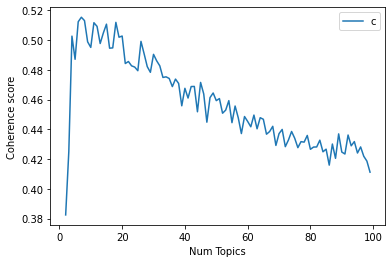

In [ ]:
# Visualization Coherence Value
limit=limit; start=start; step=step;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [ ]:
# Coherence values
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.3824
Num Topics = 3  has Coherence Value of 0.4249
Num Topics = 4  has Coherence Value of 0.5027
Num Topics = 5  has Coherence Value of 0.4871
Num Topics = 6  has Coherence Value of 0.5124
Num Topics = 7  has Coherence Value of 0.5154
Num Topics = 8  has Coherence Value of 0.5131
Num Topics = 9  has Coherence Value of 0.4989
Num Topics = 10  has Coherence Value of 0.4951
Num Topics = 11  has Coherence Value of 0.5117
Num Topics = 12  has Coherence Value of 0.5092
Num Topics = 13  has Coherence Value of 0.4977
Num Topics = 14  has Coherence Value of 0.5048
Num Topics = 15  has Coherence Value of 0.5107
Num Topics = 16  has Coherence Value of 0.4946
Num Topics = 17  has Coherence Value of 0.4948
Num Topics = 18  has Coherence Value of 0.5119
Num Topics = 19  has Coherence Value of 0.502
Num Topics = 20  has Coherence Value of 0.5027
Num Topics = 21  has Coherence Value of 0.4843
Num Topics = 22  has Coherence Value of 0.4856
Num Topics = 23  has C

In [ ]:
#prefix = str(path)

#optimal_model = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=optimal_topics, id2word=id2word, random_seed = 100, prefix = prefix)

# Select and display model
optimal_model = model_list[1]
model_topics = optimal_model.show_topics(formatted=False)
pprint(optimal_model.print_topics(num_words=25))

[(0,
  '0.027*"price" + 0.022*"rise" + 0.019*"oil" + 0.016*"tonne" + 0.016*"expect" '
  '+ 0.015*"fall" + 0.015*"increase" + 0.014*"export" + 0.013*"month" + '
  '0.012*"report" + 0.010*"end" + 0.010*"total" + 0.010*"production" + '
  '0.009*"week" + 0.008*"high" + 0.008*"low" + 0.008*"import" + '
  '0.007*"estimate" + 0.007*"product" + 0.007*"compare" + 0.006*"pct" + '
  '0.006*"early" + 0.006*"cost" + 0.006*"producer" + 0.006*"due"'),
 (1,
  '0.019*"market" + 0.018*"rate" + 0.016*"trade" + 0.012*"official" + '
  '0.012*"bank" + 0.010*"government" + 0.009*"dollar" + 0.009*"make" + '
  '0.009*"today" + 0.008*"country" + 0.007*"foreign" + 0.007*"interest" + '
  '0.007*"cut" + 0.006*"issue" + 0.006*"exchange" + 0.006*"agreement" + '
  '0.006*"give" + 0.006*"firm" + 0.006*"plan" + 0.005*"time" + 0.005*"major" + '
  '0.005*"japanese" + 0.005*"currency" + 0.005*"talk" + 0.005*"meeting"'),
 (2,
  '0.076*"dlrs" + 0.045*"ct" + 0.041*"loss" + 0.040*"share" + 0.034*"company" '
  '+ 0.031*"net" +

In [ ]:
# save lda model

#pkl_filename = str(path)+"pickle_model.pkl"
#pickle the model
#with open(pkl_filename, 'wb') as pickle_writer:
#    pickle.dump(optimal_model, pickle_writer)

# load model from pickle
#with open(pkl_filename, 'rb') as pickle_reader:
#    optimal_model = pickle.load(pickle_reader)


In [ ]:
# Calculate Coherence Score
#coherence_model_ldamallet = CoherenceModel(model=optimal_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
#coherence_ldamallet = coherence_model_ldamallet.get_coherence()
#print('\nCoherence Score: ', coherence_ldamallet)

In [ ]:
optimal_model.show_topic(2,topn=40)

[('dlrs', 0.07579609986670997),
 ('ct', 0.044982582690218306),
 ('loss', 0.04068145924573528),
 ('share', 0.04049104492657848),
 ('company', 0.033736937017663726),
 ('net', 0.030667906226548237),
 ('profit', 0.026187569305211753),
 ('sale', 0.023051333460276213),
 ('stock', 0.016812464297315158),
 ('offer', 0.015311551428667436),
 ('include', 0.01451629162513021),
 ('note', 0.014348278990580091),
 ('buy', 0.011156038934127846),
 ('unit', 0.010203967338343844),
 ('sell', 0.009386305850199936),
 ('quarter', 0.009285498269469864),
 ('dividend', 0.008434234254415932),
 ('earning', 0.008355828358292544),
 ('record', 0.00832222583138252),
 ('gain', 0.008019803089192307),
 ('pay', 0.007728581189305436),
 ('common', 0.007403756762508541),
 ('shareholder', 0.006978124754981574),
 ('acquisition', 0.006910919701161527),
 ('business', 0.006821312962734798),
 ('cash', 0.006608496958971315),
 ('group', 0.006406881797511173),
 ('result', 0.006362078428297808),
 ('operation', 0.006082057370714278),
 (

# Visualization

In [ ]:
# conversion of a lda mallet model to lda model for visualization with pyLDAvis
model = gensim.models.wrappers.ldamallet.malletmodel2ldamodel(optimal_model)

In [ ]:
# Visualization of the optimal model with pyLDAvis
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(model, corpus, id2word)
vis

/usr/local/lib/python3.6/dist-packages/pyLDAvis/_prepare.py:223: RuntimeWarning: divide by zero encountered in log
  kernel = (topic_given_term * np.log((topic_given_term.T / topic_proportion).T))
/usr/local/lib/python3.6/dist-packages/pyLDAvis/_prepare.py:240: RuntimeWarning: divide by zero encountered in log
  log_lift = np.log(topic_term_dists / term_proportion)
/usr/local/lib/python3.6/dist-packages/pyLDAvis/_prepare.py:241: RuntimeWarning: divide by zero encountered in log
  log_ttd = np.log(topic_term_dists)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3     -0.099356 -0.205349       1        1  14.602143
7     -0.184472 -0.001458       2        1  14.122313
4     -0.148029 -0.167118       3        1  13.641816
2     -0.124521  0.257799       4        1  13.278269
0     -0.139918  0.170964       5        1  11.721304
5      0.122673 -0.016553       6        1  11.613960
6      0.228760 -0.222613       7        1  11.598041
1      0.344863  0.184328       8        1   9.422154, topic_info=        Term         Freq        Total Category  logprob  loglift
27      dlrs  6874.000000  6874.000000  Default  30.0000  30.0000
178       ct  4029.000000  4029.000000  Default  29.0000  29.0000
266     loss  3644.000000  3644.000000  Default  28.0000  28.0000
153    share  4036.000000  4036.000000  Default  27.0000  27.0000
267      net  2747.000000  2747.000000  Default  26.0000  26.0000
..       ...          ...          ...      ...      ...      ...
33       end   286.955738  1625.024718   Topic8  -4.7592   0.6282
593   fiscal   153.511286   421.799527   Topic8  -5.3847   1.3514
194  earning   187.624906   850.302608   Topic8  -5.1840   0.8510
121  current   172.574780   861.390567   Topic8  -5.2676   0.7544
153    share   219.731841  4036.724438   Topic8  -5.0261  -0.5487

[685 rows x 6 columns], token_table=      Topic      Freq         Term
term                              
751       3  0.806653       accord
751       5  0.192665       accord
109       6  0.386660      acquire
109       7  0.614107      acquire
350       6  0.572771  acquisition
...     ...       ...          ...
164       4  0.064760         year
164       5  0.284946         year
164       6  0.289263         year
1790      2  1.000052          yen
3939      1  1.000575      yeutter

[849 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 8, 5, 3, 1, 6, 7, 2])

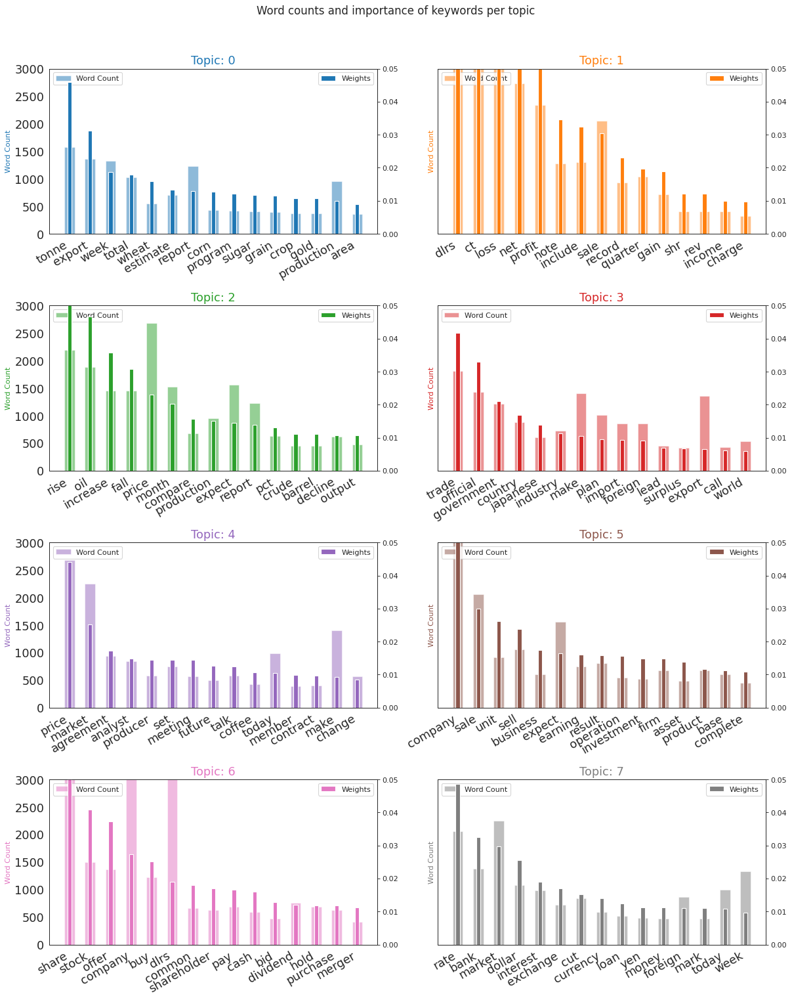

In [ ]:
# seaborn visualization of topics

topics = optimal_model.show_topics(formatted=False, num_words= 15)
data_flat = [w for w_list in data_lemmatized for w in w_list]


counter = Counter(data_flat)

i = 0
out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

plt.rcParams['figure.dpi'] = 80
df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])   
writer = pd.ExcelWriter(str(path)+'topiccounts.xlsx', engine='xlsxwriter')
df.to_excel(writer, sheet_name='welcome', index=False)
writer.save()     
sns.set_style("white")
# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(4, 2, figsize=(15,18), sharey=True)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.5, label='Word Count')
    ax_twin = ax.twinx()
    ax.tick_params(labelsize=16)
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.05); ax.set_ylim(0, 3000)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)  
fig.suptitle('Word counts and importance of keywords per topic', fontsize=15, y=1.05)    
plt.show()

# Google Bert Topic Modeling

## Imports and configuration

In [ ]:
!pip install bertopic
!pip install transformers

     |████████████████████████████████| 71kB 3.6MB/s 
     |████████████████████████████████| 6.4MB 8.9MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 1.8MB 37.9MB/s 
     |████████████████████████████████| 1.2MB 45.6MB/s 
     |████████████████████████████████| 3.2MB 50.6MB/s 
     |████████████████████████████████| 890kB 33.6MB/s 
  Created wheel for hdbscan: filename=hdbscan-0.8.27-cp36-cp36m-linux_x86_64.whl size=2311368 sha256=a083f5eff189c206ce04402ce7ae19fb95e8cd8e6097c63e6694f3d6d9f2fbd6
  Stored in directory: /root/.cache/pip/wheels/42/63/fb/314ad6c3b270887a3ecb588b8e5aac50b0fad38ff89bb6dff2
Successfully built hdbscan
  Created wheel for sentence-transformers: filename=sentence_transformers-0.4.1.2-cp36-none-any.whl size=103068 sha256=50550ca6c33827ede64cdd853be64e687090a3e9cff6cce66cdc6981e1c42195
  Stored in directory: /root/.cache/pip/wheels/3d/33/d1/5

## Train Google Bert

In [ ]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('distilbert-base-nli-mean-tokens')
embeddings = model.encode(train_data, show_progress_bar=True)

In [ ]:
import umap.umap_ as umap

embeddings = model.encode(data_words_nostops, show_progress_bar=True)

umap_embeddings = umap.UMAP(n_neighbors=15, 
                            n_components=7, 
                            metric='cosine').fit_transform(embeddings)

In [ ]:
!pip install hdbscan

In [ ]:
import hdbscan
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(umap_embeddings)

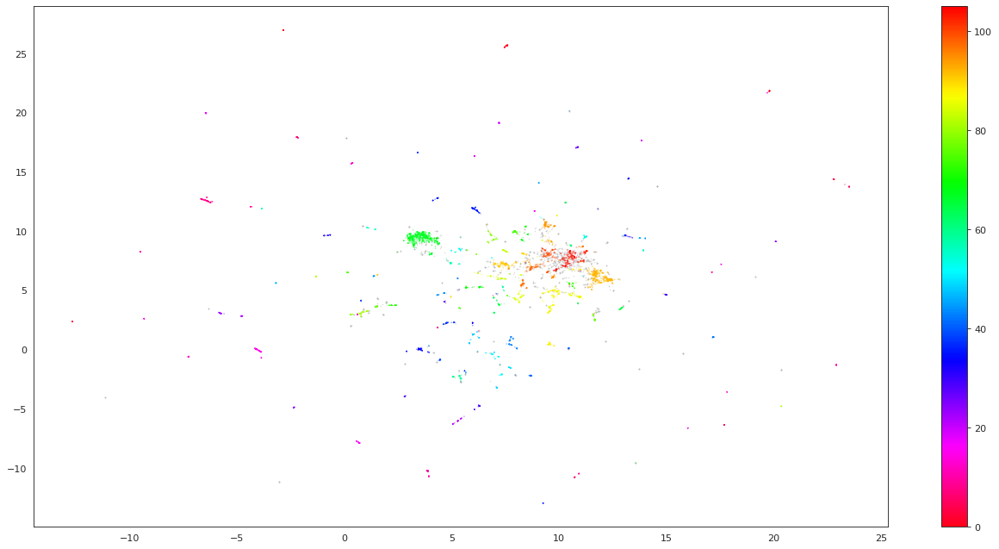

In [ ]:
import matplotlib.pyplot as plt

# Prepare data
umap_data = umap.UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = cluster.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=0.05)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.05, cmap='hsv_r')
plt.colorbar()

In [ ]:
docs_df = pd.DataFrame(train_data, columns=["Doc"])
docs_df['Topic'] = cluster.labels_
docs_df['Doc_ID'] = range(len(docs_df))
docs_per_topic = docs_df.groupby(['Topic'], as_index = False).agg({'Doc': ' '.join})

In [ ]:
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer


def c_tf_idf(documents, m, ngram_range=(1, 1)):
    count = CountVectorizer(ngram_range=ngram_range,stop_words=stop_words).fit(documents)
    t = count.transform(documents).toarray()
    w = t.sum(axis=1)
    tf = np.divide(t.T, w)
    sum_t = t.sum(axis=0)
    idf = np.log(np.divide(m, sum_t)).reshape(-1, 1)
    tf_idf = np.multiply(tf, idf)

    return tf_idf, count
  
tf_idf, count = c_tf_idf(docs_per_topic.Doc.values, m=len(train_data))

## Results

In [ ]:
def extract_top_n_words_per_topic(tf_idf, count, docs_per_topic, n=20):
    words = count.get_feature_names()
    labels = list(docs_per_topic.Topic)
    tf_idf_transposed = tf_idf.T
    indices = tf_idf_transposed.argsort()[:, -n:]
    top_n_words = {label: [(words[j], tf_idf_transposed[i][j]) for j in indices[i]][::-1] for i, label in enumerate(labels)}
    return top_n_words

def extract_topic_sizes(df):
    topic_sizes = (df.groupby(['Topic'])
                     .Doc
                     .count()
                     .reset_index()
                     .rename({"Topic": "Topic", "Doc": "Size"}, axis='columns')
                     .sort_values("Size", ascending=False))
    return topic_sizes

top_n_words = extract_top_n_words_per_topic(tf_idf, count, docs_per_topic, n=30)
topic_sizes = extract_topic_sizes(docs_df); topic_sizes.head(10)

,Topic,Size
0,-1,1463
68,67,625
93,92,443
88,87,177
105,104,169
92,91,162
16,15,131
9,8,128
95,94,121
87,86,106


In [ ]:
print(top_n_words[67])

[('inc', 0.010935256017391402), ('corp', 0.010583920761444442), ('company', 0.009953454114009818), ('share', 0.009182168751305368), ('shares', 0.008774374044196752), ('stock', 0.008147366156926947), ('acquisition', 0.008130504130057496), ('common', 0.008037752926386192), ('earnings', 0.00775254385160503), ('unit', 0.007544930294291525), ('merger', 0.00700079236433933), ('quarter', 0.006901318829682637), ('co', 0.006815027850354751), ('shareholders', 0.006658045033332205), ('offer', 0.006490895256295638), ('dividend', 0.006311693347513059), ('chemlawn', 0.006268974006052679), ('acquire', 0.005970060433052166), ('cash', 0.0058992823605404756), ('per', 0.005881632677491101), ('board', 0.00587864962677716), ('ltd', 0.005833492736299106), ('31', 0.00566402961855097), ('sale', 0.0054226163301741665), ('agreement', 0.005349316131028016), ('subsidiary', 0.005298990548667078), ('shr', 0.00520230219789064), ('net', 0.005198285873600714), ('revs', 0.005146418540443612), ('sales', 0.00506446117149

In [ ]:
print(top_n_words[92])

[('shr', 0.02136939884502659), ('qtr', 0.019843000461067795), ('revs', 0.018648983524528744), ('loss', 0.018348614456976636), ('profit', 0.017908645237807583), ('net', 0.015813108129076013), ('oper', 0.015192867621489132), ('4th', 0.014734750511724922), ('corp', 0.013340946327512341), ('note', 0.013099861806042414), ('cts', 0.011576171808160972), ('avg', 0.010858427674921367), ('shrs', 0.010787249375764882), ('mths', 0.01073409659278491), ('includes', 0.010027627309985765), ('31', 0.009858551272598779), ('prior', 0.009785460713564518), ('qtly', 0.009172888687366404), ('sales', 0.009145406019386052), ('div', 0.009131225469192967), ('gain', 0.008938705511975084), ('inc', 0.008844151602759285), ('nine', 0.008411031672860177), ('jan', 0.007942579427738003), ('record', 0.007486190469487194), ('28', 0.00744619595659283), ('dividend', 0.007306552883205334), ('11', 0.007195187923235145), ('12', 0.007056107274732538), ('excludes', 0.007005457912815798)]


In [ ]:
print(top_n_words[87])

[('loss', 0.018828451375849563), ('revs', 0.018551433904960623), ('shr', 0.01727364448548438), ('qtr', 0.01606258983525309), ('profit', 0.01396275187466135), ('shrs', 0.013402619718083791), ('avg', 0.013366138029448327), ('net', 0.013236398427274153), ('computer', 0.013215466983901938), ('inc', 0.012537126076250555), ('note', 0.010884525113400653), ('oper', 0.010602969845983362), ('medical', 0.009772352964446595), ('31', 0.009692719127463709), ('cts', 0.00932151200414624), ('electronics', 0.009214373648623502), ('graphics', 0.009170067601613973), ('nine', 0.009165416219174003), ('4th', 0.008851554815864228), ('mths', 0.008772627440621341), ('systems', 0.008496885028548177), ('health', 0.008400947220038065), ('cyclops', 0.008090062751259104), ('scan', 0.007751604368925466), ('company', 0.007646116573996481), ('includes', 0.007591392356152502), ('laboratories', 0.00753027012894382), ('sales', 0.0074030591318319135), ('six', 0.007290573866743928), ('quarter', 0.007160545558738753)]


In [ ]:
print(top_n_words[104])

[('group', 0.011461817847318338), ('api', 0.009838482855670067), ('boliden', 0.009146014038565166), ('says', 0.008670368534111104), ('barrels', 0.0078076072084433895), ('futures', 0.00717533450613894), ('stocks', 0.006513856156187324), ('normal', 0.006453844471237748), ('stake', 0.006352209028931602), ('profit', 0.006171661128680916), ('francs', 0.0061674424624222155), ('sec', 0.006149425441970113), ('cbt', 0.006032685547113235), ('cbi', 0.006030688341075218), ('exchange', 0.006029255582450652), ('operations', 0.005961340914713628), ('crowns', 0.005889860346372715), ('gas', 0.005876376736061413), ('distillate', 0.005733400419806223), ('loss', 0.005616553355778068), ('shares', 0.005556366058773217), ('sales', 0.005486882703738206), ('offer', 0.005413951224349099), ('dole', 0.00539284029261982), ('members', 0.005273649993635388), ('crude', 0.005244878144775003), ('opec', 0.005218487080092472), ('official', 0.005194808878885531), ('tmoc', 0.005087416161041131), ('share', 0.005025021090810

In [ ]:
# Wordcloud 
from wordcloud import WordCloud

def show_wordcloud(data, title = ""):
    wordcloud = WordCloud(
        background_color='white',
        regexp = "\w[\w]+",
        max_words=200,
        max_font_size=40, 
        scale=3,
        random_state=1 # chosen at random by flipping a coin; it was heads
    ).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

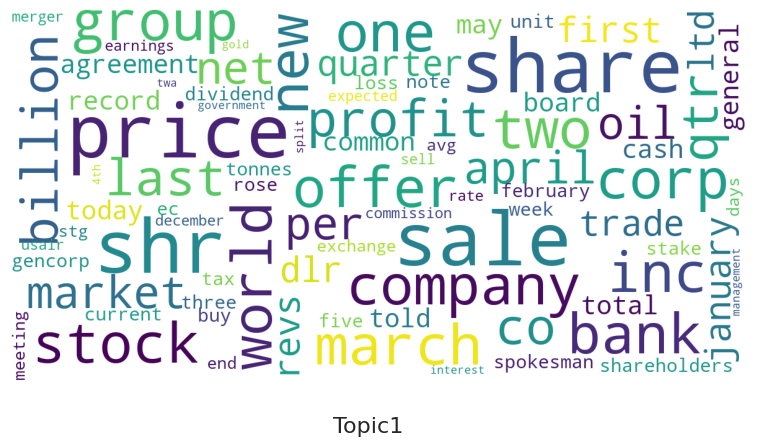

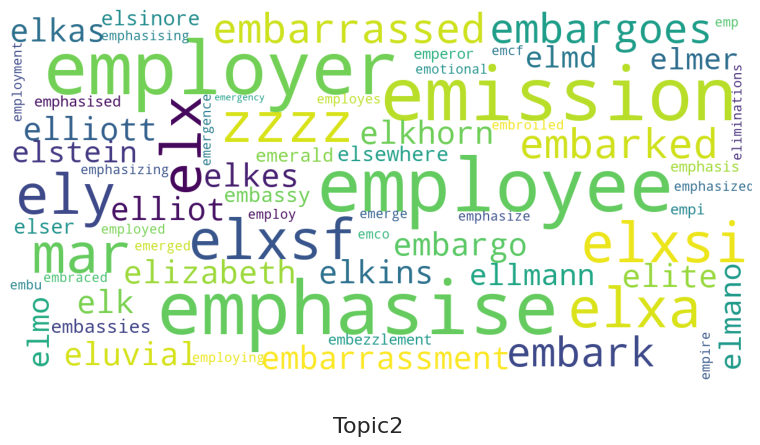

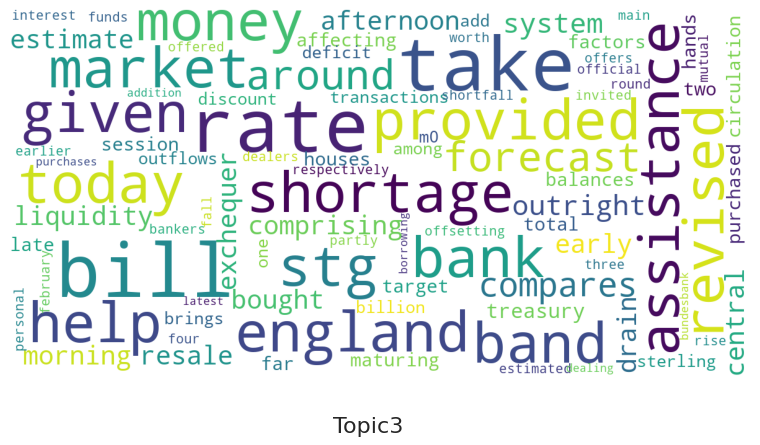

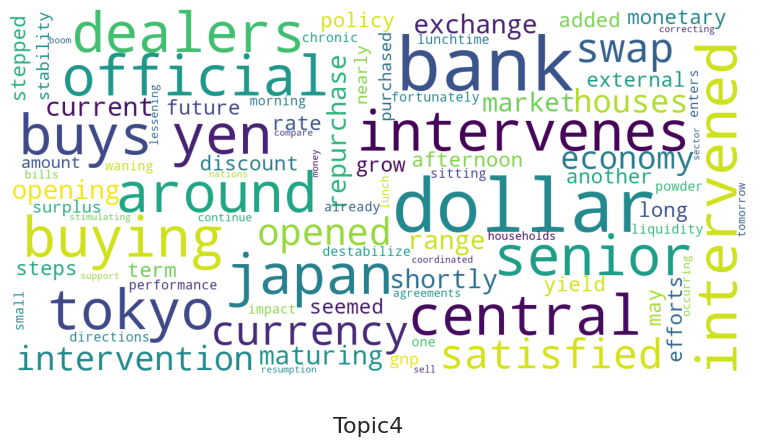

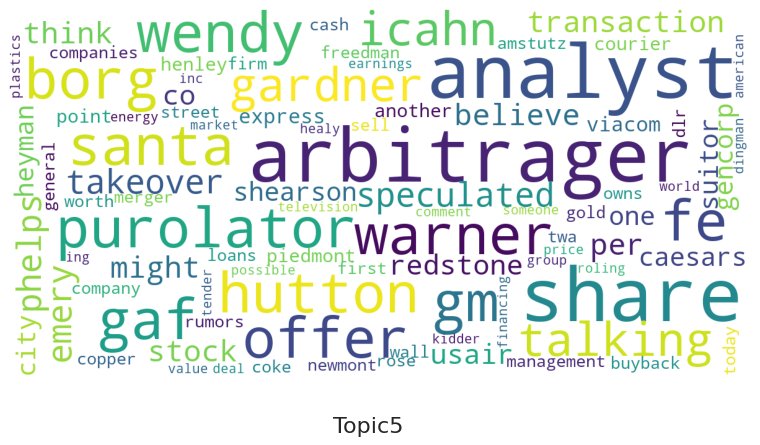

...

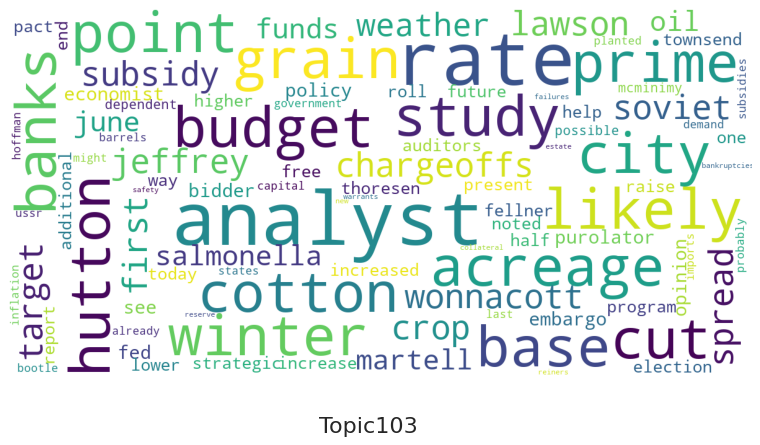

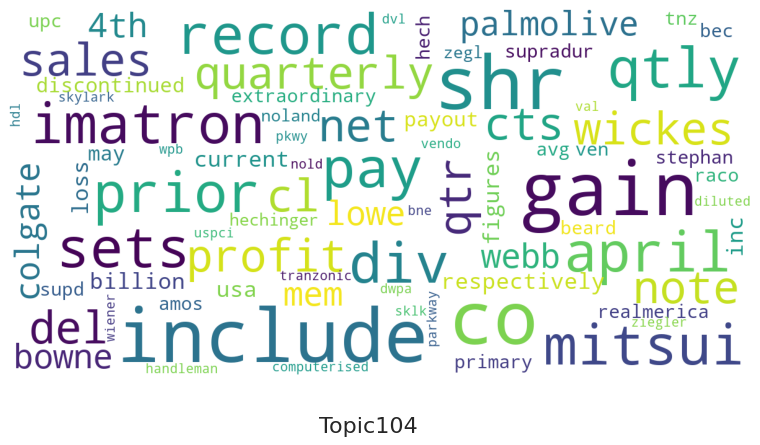

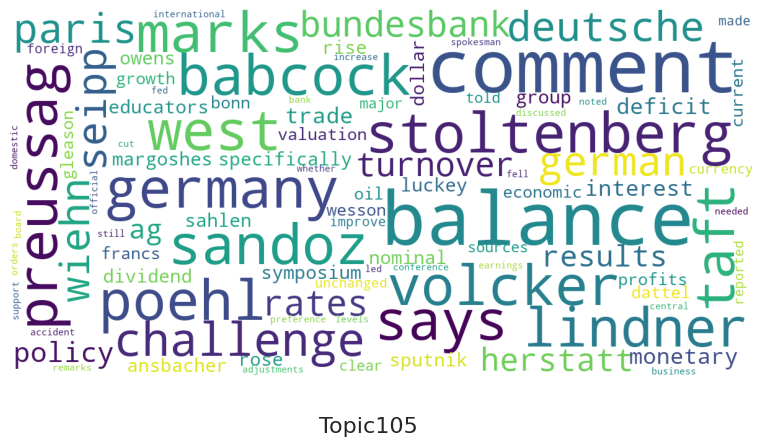

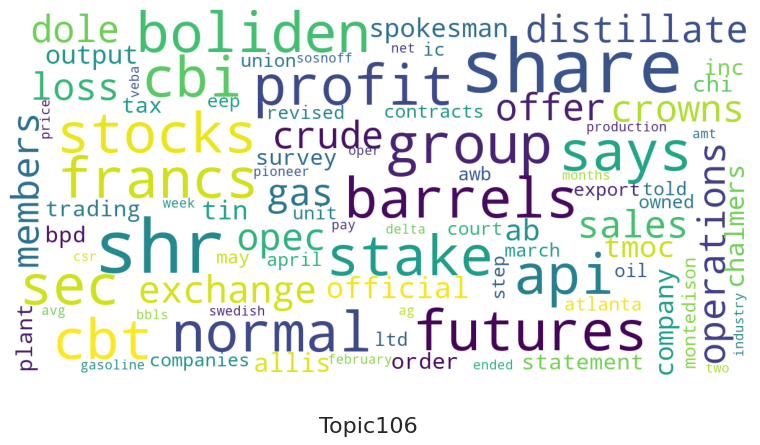

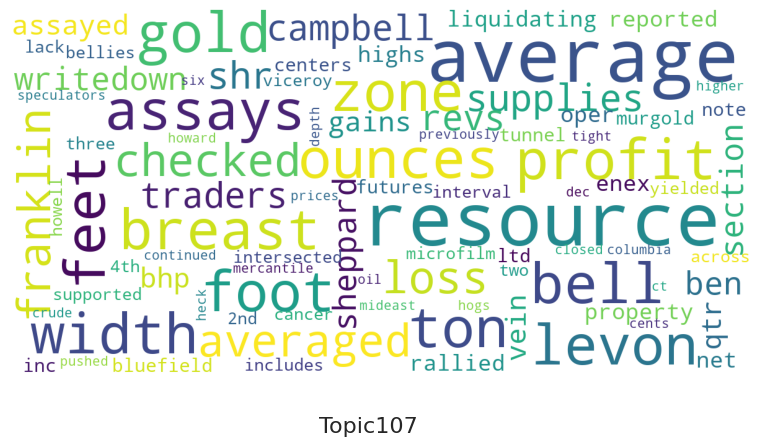

In [ ]:
x= top_n_words
i=0
#topics_words = [(tp[0], [wd[0] for wd in tp[1]]) for tp in x]

topics_words = [(x, [wd[0] for wd in x[i]]) for i in x]

    
list1=[]
for topic,words in topics_words:
    list1.append(words)   
  
c = 1
for x in list1:
    titel = "Topic"+str(c) 
    show_wordcloud(x,titel)
    c+=1
